<a href="https://colab.research.google.com/github/skyprince999/100-Days-Of-ML/blob/master/Day_24_eo_learn_Example.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [0]:
!pip install sentinelhub --upgrade

In [0]:
!pip install eo-learn
#!pip install eo-learn-visualization[FULL]

In [0]:
!pip install s2cloudless

In [4]:
!rm -rf time-lapse
!git clone https://github.com/sentinel-hub/time-lapse
import sys
sys.path.append('time-lapse')

Cloning into 'time-lapse'...
remote: Enumerating objects: 26, done.
remote: Total 26 (delta 0), reused 0 (delta 0), pack-reused 26
Unpacking objects: 100% (26/26), done.


In [0]:
%reload_ext autoreload
%autoreload 2
%matplotlib inline

import matplotlib.pyplot as plt
import numpy as np

In [0]:
from time_lapse import SentinelHubTimelapse

In [0]:
from sentinelhub.geometry import BBox, CRS

In [0]:
WMS_INSTANCE = '<add your instance id. it shoudl be from one of the Python templates>'

In [0]:
# Consuruction of Daxing airpirt over 3 years
daxing_airport = BBox(bbox=[116.3287, 39.4651, 116.4935, 39.5366], 
                      crs=CRS.WGS84)
time_interval = ['2015-01-01', '2018-01-31']

In [0]:
tl_size = (int(1920/2),int(1080/2))

In [20]:
# This initializes the SentinelHubTimelapse object. However it does that using the following layer = 'TRUE_COLOR'. 
#This can probably be changed by passing the parameter from here. At first I changed the ID name Not the name of the layer. 
# Instead I will try by passing the actual layer name

daxing_timelapse = SentinelHubTimelapse('daxing-airport-twitter',
                                        daxing_airport, 
                                        time_interval, 
                                        WMS_INSTANCE,
                                        layer='TRUE-COLOR-S2-L1C',
                                        full_size=tl_size)


/usr/local/lib/python3.6/dist-packages/sentinelhub/data_request.py:47: SHDeprecationWarning: Parameter 'instance_id' is deprecated and will soon removed. Use parameter 'config' instead
  category=SHDeprecationWarning)


In [0]:
daxing_timelapse.get_previews() 

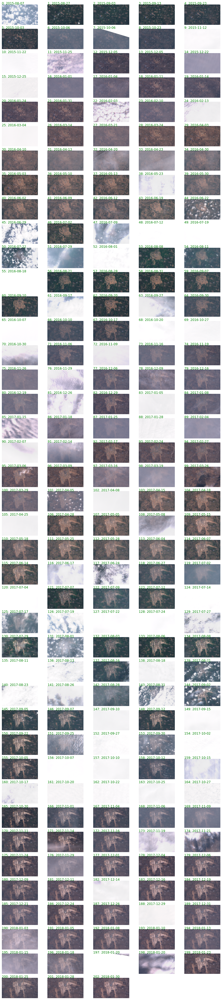

In [22]:
daxing_timelapse.plot_preview(filename='previews.pdf')

In [24]:
%%time
daxing_timelapse.save_fullres_images()

CPU times: user 26.5 s, sys: 1.89 s, total: 28.3 s
Wall time: 1min 18s


In [0]:
daxing_timelapse.mask_invalid_images(max_invalid_coverage=0.01)

In [26]:
%%time
daxing_timelapse.mask_cloudy_images(max_cloud_coverage=0.01)

CPU times: user 4min 29s, sys: 509 ms, total: 4min 30s
Wall time: 2min 48s


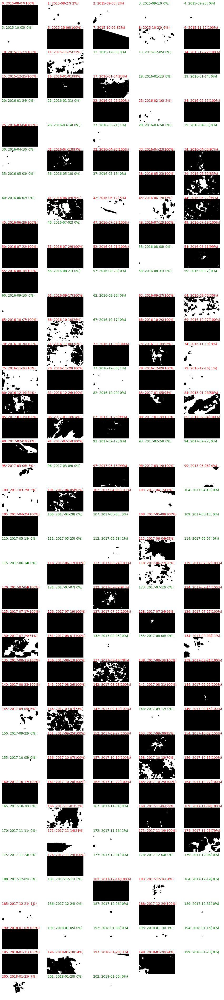

In [27]:
daxing_timelapse.plot_cloud_masks(filename='cloudmasks.pdf')

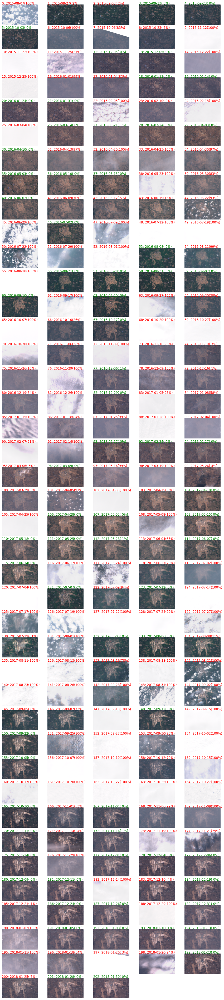

In [28]:
daxing_timelapse.plot_preview(filename='previews_with_cc.pdf')

In [0]:
daxing_timelapse.create_date_stamps()
#daxing_timelapse.create_timelapse(scale_factor=0.2) # <<< This doesn't work right now

In [0]:
daxing_timelapse.make_gif(fps=8, filename='daxing_airport_8fps.gif')

In [0]:

def make_timelapse(msg, bbox, time_interval, *, full_size=(int(1920 / 4.1), int(1080 / 4.1)), mask_images=[],
                   max_cc=0.01, scale_factor=0.2, fps=8, instance_id=WMS_INSTANCE, layer = 'TRUE-COLOR-S2-L1C', **kwargs):
    timelapse = SentinelHubTimelapse(msg, bbox, time_interval, instance_id,
                                     full_size=full_size, layer=layer, **kwargs)
    timelapse.get_previews()
    timelapse.save_fullres_images()
    timelapse.plot_preview(filename='previews.pdf')
    timelapse.mask_cloudy_images(max_cloud_coverage=max_cc)
    timelapse.plot_cloud_masks(filename='cloudmasks.pdf')
    timelapse.plot_preview(filename='previews_with_cc.pdf')
    timelapse.mask_images(mask_images)
    #timelapse.create_date_stamps()
    #timelapse.create_timelapse(scale_factor=scale_factor)

    timelapse.make_gif(fps=fps)
    #timelapse.make_video(fps=fps)

/usr/local/lib/python3.6/dist-packages/sentinelhub/data_request.py:47: SHDeprecationWarning: Parameter 'instance_id' is deprecated and will soon removed. Use parameter 'config' instead
  category=SHDeprecationWarning)


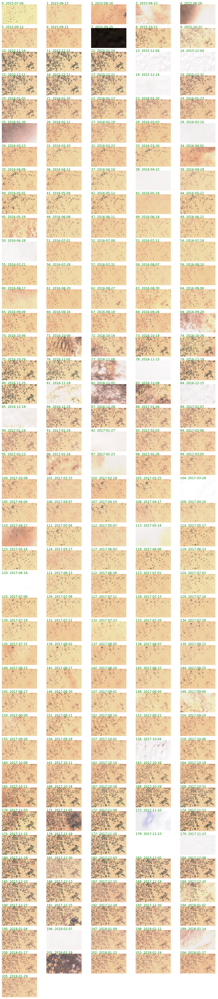

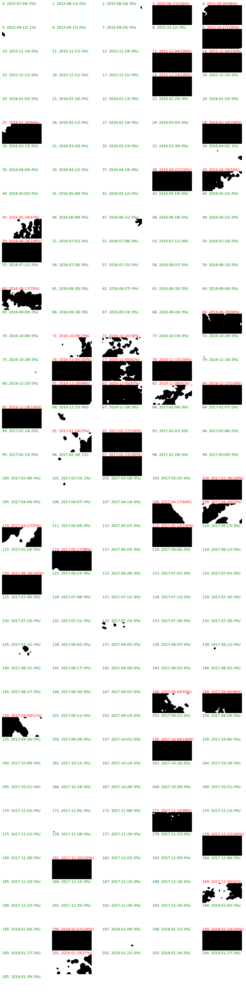

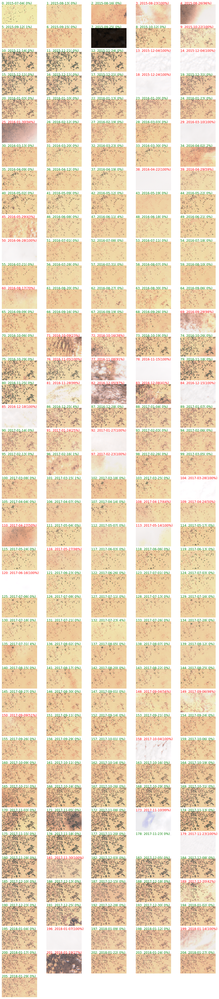

In [39]:
sahara_fields = BBox(bbox=[6.6574, 33.3352, 6.7453, 33.3719],
                     crs=CRS.WGS84)

mask_idxs = [7, 96, 112, 170, 186, 190]

make_timelapse(msg='sahara-fields-mediumres', bbox=sahara_fields, time_interval=time_interval,
               mask_images=mask_idxs, max_cc=0.1, scale_factor=0.2)

/usr/local/lib/python3.6/dist-packages/sentinelhub/data_request.py:47: SHDeprecationWarning: Parameter 'instance_id' is deprecated and will soon removed. Use parameter 'config' instead
  category=SHDeprecationWarning)


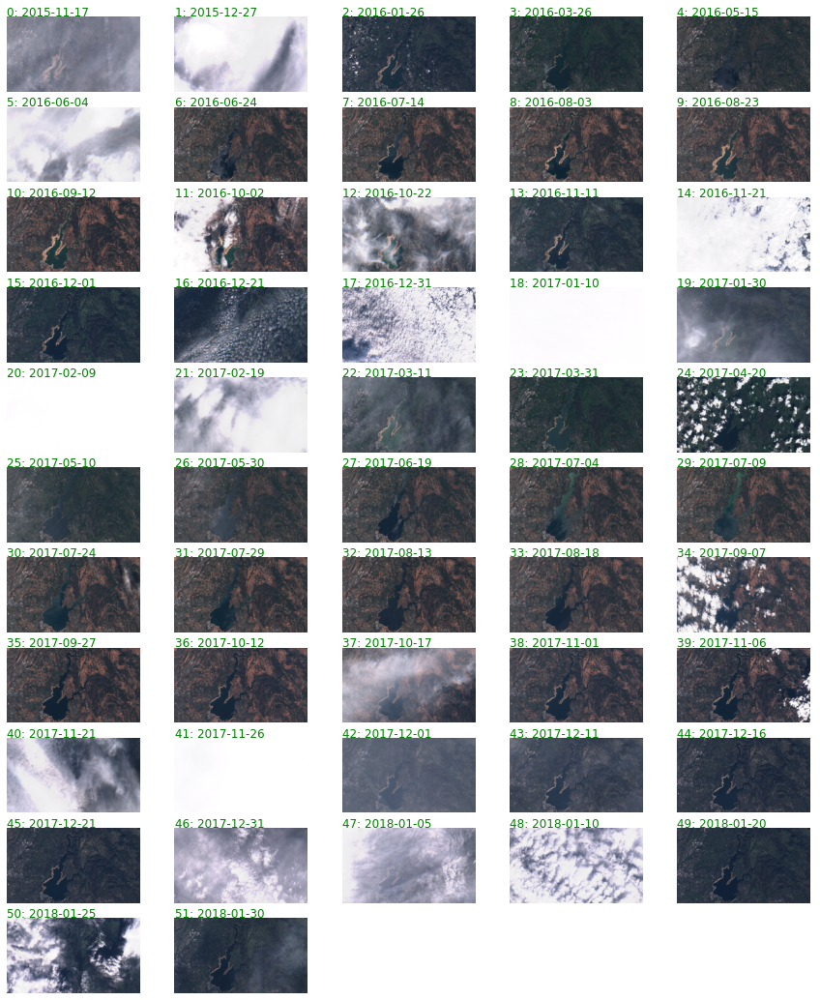

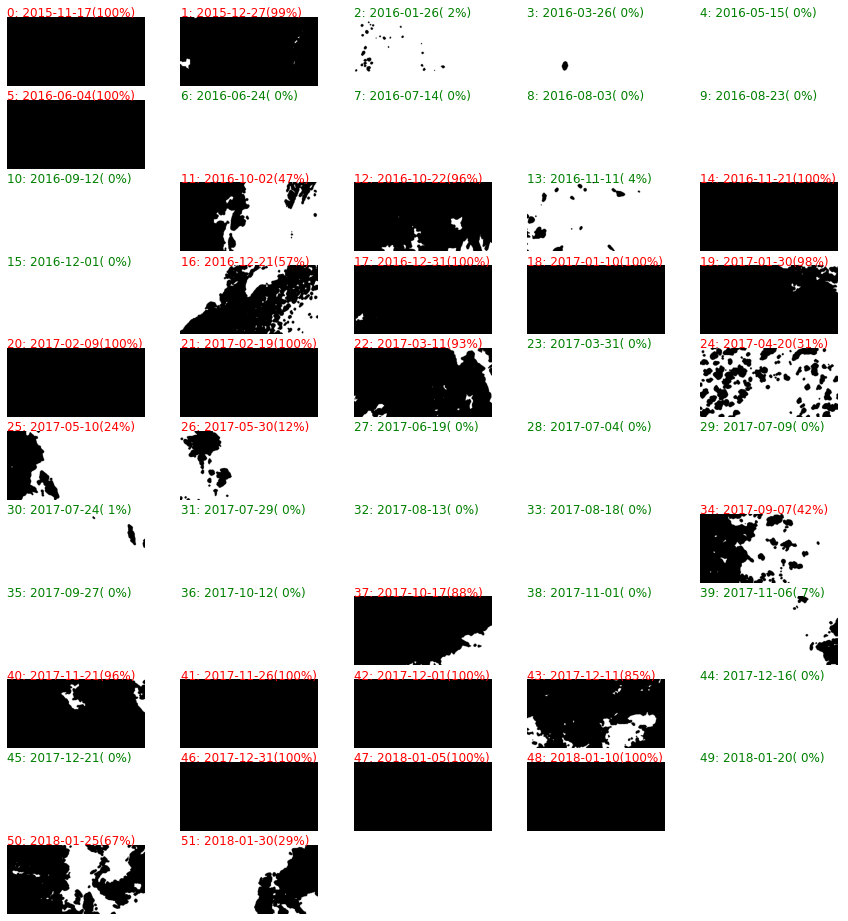

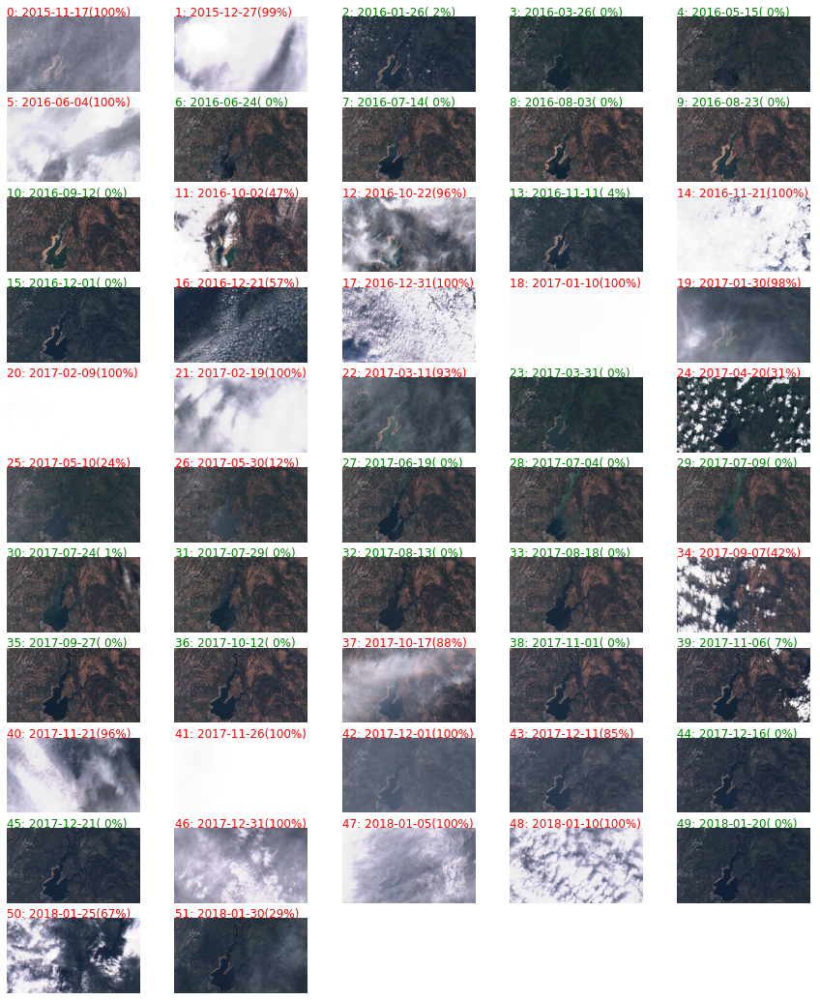

In [40]:
folsom_lake = BBox(bbox=[-121.2654, 38.6938, -120.9138, 38.8309],
                   crs=CRS.WGS84)

make_timelapse(msg='folsom-mediumres', bbox=folsom_lake, time_interval=time_interval, max_cc=0.1)

/usr/local/lib/python3.6/dist-packages/sentinelhub/data_request.py:47: SHDeprecationWarning: Parameter 'instance_id' is deprecated and will soon removed. Use parameter 'config' instead
  category=SHDeprecationWarning)


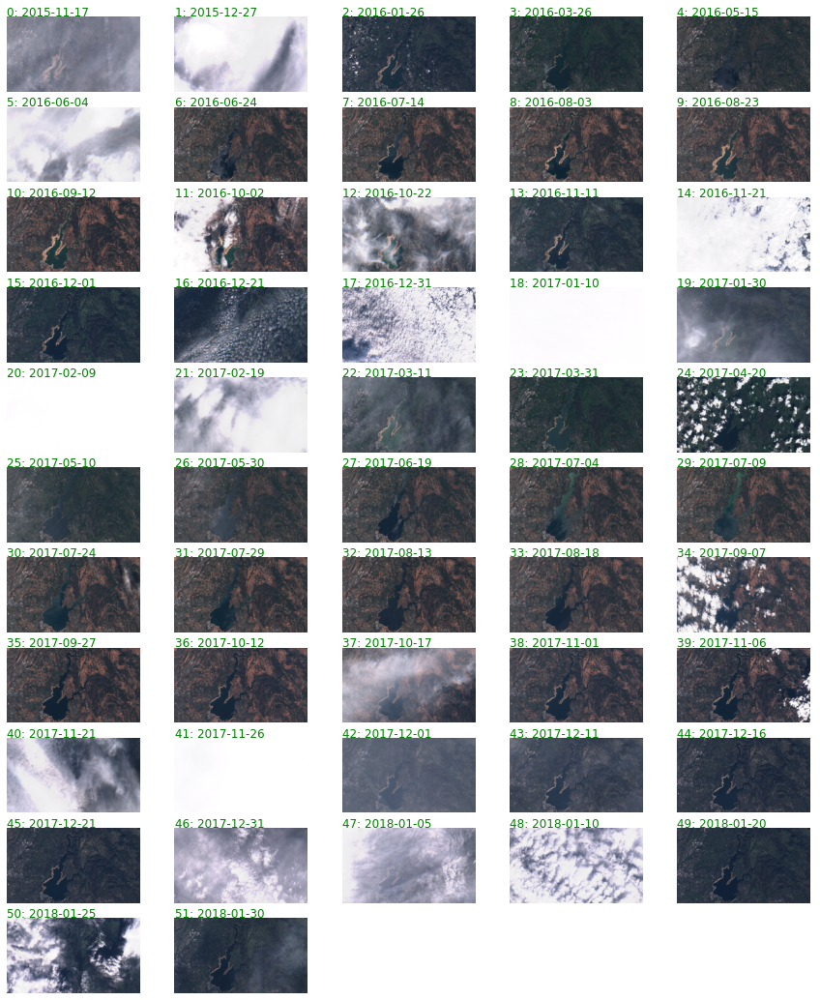

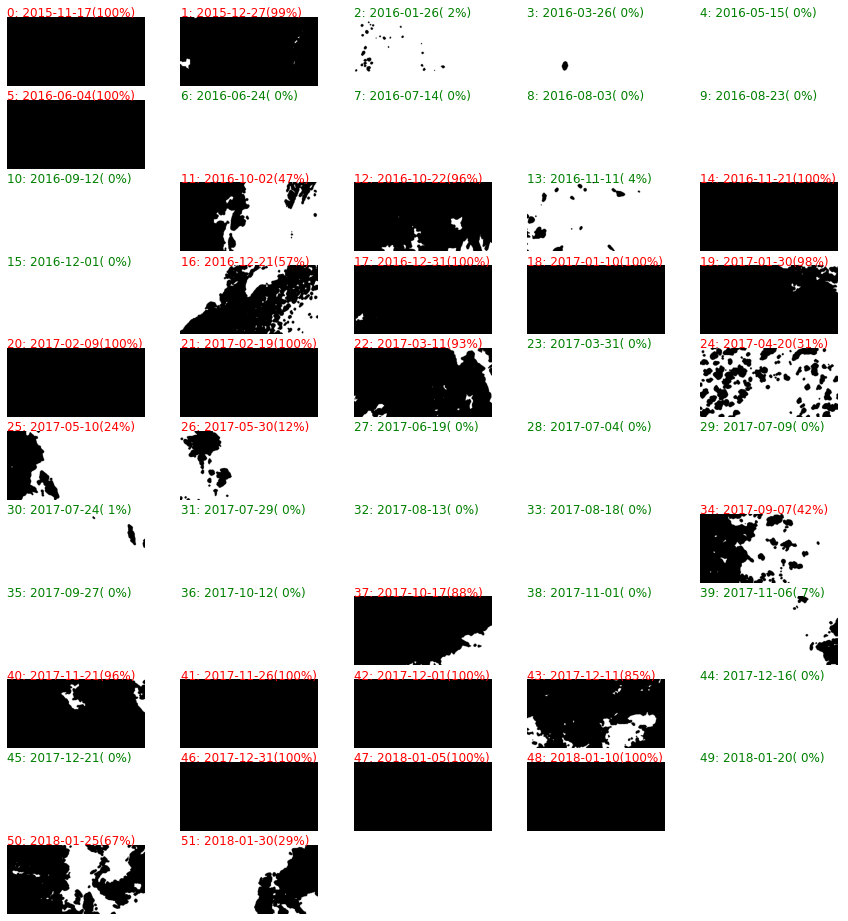

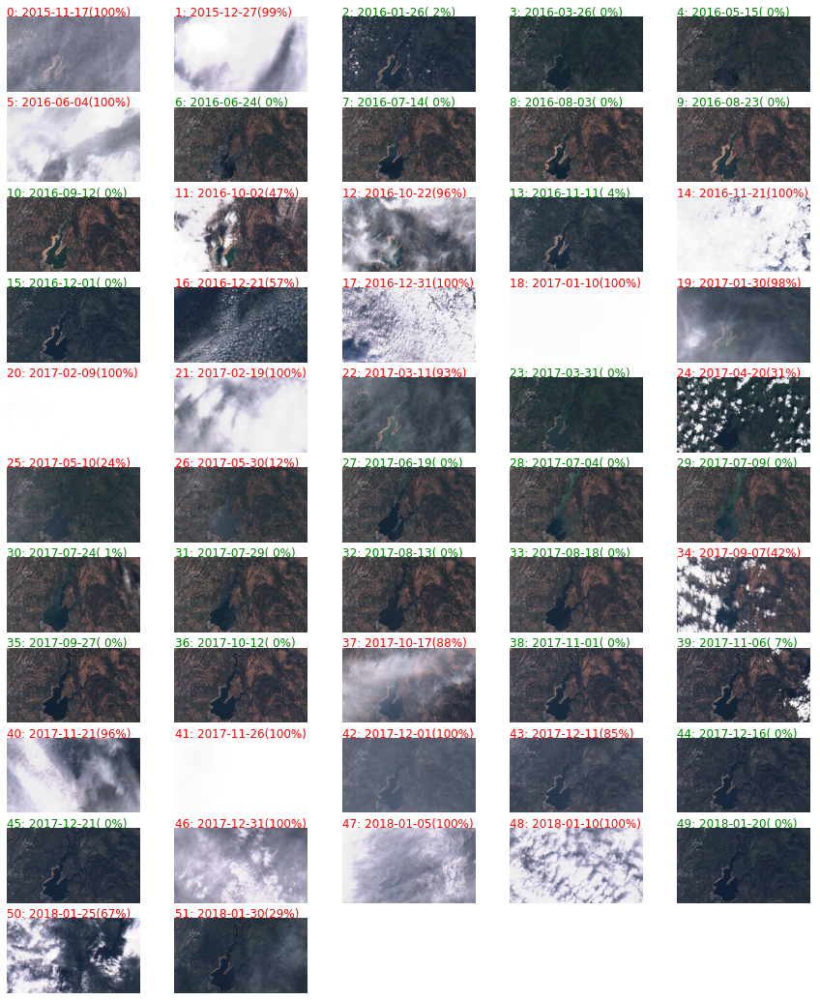

In [42]:
bandra_sealink = BBox(bbox = [19.046573, 72.806997, 19.010303, 72.833261], 
                     crs=CRS.WGS84 )

time_interval = ['2000-01-01', '2018-01-31']

make_timelapse(msg='bandra-sealink', bbox=folsom_lake, time_interval=time_interval, max_cc=0.1)